In [13]:
import sys
sys.path.append('../')
import plotly.graph_objects as go
import plotly.express as px
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import pandas as pd
from src.finance_ml.data_preparation.data_preparation import DataLoader
from src.finance_ml.data_preparation.asset_class import Asset
from src.finance_ml.data_preparation.dataTransformer_class import DataTransformer
import warnings
warnings.filterwarnings('ignore')
#seaborn-0.13.0

This notebook was created by Ahmed Ibrahim, Brijesh Mandaliya & Moritz Link on the Mon Nov 27 12:33:00 2023

### Data Loader

In [2]:
dataloader = DataLoader(time_index_col= 'DATE', keep_cols = ['VOLUME','OPEN', "HIGHT",'CLOSE', 'LOW', 'TRANSACTIONS'])
assets = {'GOLD':'../data/commodities/GLD_2020-04-07_2022-04-06.parquet'}
gold_asset = dataloader.load_dataset(assets)
gold_asset.head()

,GOLD_VOLUME,GOLD_OPEN,GOLD_HIGHT,GOLD_CLOSE,GOLD_LOW,GOLD_TRANSACTIONS
DATE,,,,,,
2020-04-07 15:43:00,21071.0,155.880,155.94,155.926,155.860,152.0
2020-04-07 15:44:00,23010.0,155.930,155.97,155.900,155.900,165.0
2020-04-07 15:45:00,31544.0,155.920,155.94,155.735,155.720,292.0
2020-04-07 15:46:00,42645.0,155.760,155.84,155.840,155.760,153.0
2020-04-07 15:47:00,3735.0,155.805,155.82,155.810,155.795,47.0


In [3]:
gold_asset.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 279478 entries, 2020-04-07 15:43:00 to 2022-04-06 23:54:00
Data columns (total 6 columns):
 #   Column             Non-Null Count   Dtype  
---  ------             --------------   -----  
 0   GOLD_VOLUME        279478 non-null  float64
 1   GOLD_OPEN          279478 non-null  float64
 2   GOLD_HIGHT         279478 non-null  float64
 3   GOLD_CLOSE         279478 non-null  float64
 4   GOLD_LOW           279478 non-null  float64
 5   GOLD_TRANSACTIONS  279472 non-null  float64
dtypes: float64(6)
memory usage: 14.9 MB


In [6]:
fig = px.line(x=gold_asset.index, y=gold_asset.GOLD_CLOSE, title='Gold asset')
fig.update_layout(
    xaxis_title="Date",
    yaxis_title="GOLD_CLOSE",

)
fig.show()

### Tick Bars

In [7]:
bar_type = "tick"
bar_parameter = 20000
assets_df = gold_asset

dt = DataTransformer(assets)
tick_bar_df = dt.transform(assets_df=assets_df, bar_type=bar_type, bar_parameter=bar_parameter)


print(tick_bar_df.head(5))
print(tick_bar_df.info())

=====
asset: GOLD


100%|██████████| 13/13 [00:00<00:00, 848.63it/s]

                     GOLD_OPEN  GOLD_HIGHT  GOLD_LOW  GOLD_CLOSE  GOLD_VOLUME  \
DATE                                                                            
2020-06-01 12:47:00    155.880      166.00   154.500    163.1500  433365787.0   
2020-07-21 18:27:00    163.070      173.25   157.035    173.0519  355846333.0   
2020-09-01 14:41:00    173.060      194.88   172.780    185.1100  566020008.0   
2020-10-21 17:49:00    185.125      185.92   173.530    180.6350  318255997.0   
2020-12-11 09:10:00    180.640      185.27   165.580    171.8600  343244160.0   

                     GOLD_TRANSACTIONS  
DATE                                    
2020-06-01 12:47:00          3222841.0  
2020-07-21 18:27:00          2482588.0  
2020-09-01 14:41:00          4045729.0  
2020-10-21 17:49:00          2347468.0  
2020-12-11 09:10:00          2506923.0  
<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 13 entries, 2020-06-01 12:47:00 to 2022-02-18 18:10:00
Data columns (total 6 columns):
 #   

In [8]:
fig = px.line(x=tick_bar_df.index, y=tick_bar_df.GOLD_CLOSE, title='Tick bars: Gold asset')
fig.update_layout(xaxis_title="Date",yaxis_title="GOLD_CLOSE")
fig.show()
fig = go.Figure(data=[go.Candlestick(x=tick_bar_df.index,
                open=tick_bar_df['GOLD_OPEN'],
                high=tick_bar_df['GOLD_HIGHT'],
                low=tick_bar_df['GOLD_LOW'],
                close=tick_bar_df['GOLD_CLOSE'])])
fig.update_layout(xaxis_title="Date",)
fig.show()

### Volume Bars

In [9]:
bar_type = "volume"
bar_parameter = 2000000
assets_df = gold_asset

dt = DataTransformer(assets)
volume_bar_df = dt.transform(assets_df=assets_df, bar_type=bar_type, bar_parameter=bar_parameter)


print(volume_bar_df.head(5))
print(volume_bar_df.info())

=====
asset: GOLD


100%|██████████| 279472/279472 [00:06<00:00, 44951.12it/s]


                     GOLD_OPEN  GOLD_HIGHT  GOLD_LOW  GOLD_CLOSE  GOLD_VOLUME  \
DATE                                                                            
2020-04-07 17:39:00   155.8800      156.00  154.6800    154.7900    2043693.0   
2020-04-07 19:26:00   154.7798      155.55  154.5223    155.3300    2010308.0   
2020-04-08 13:45:00   155.3400      156.20  154.5000    155.7613    2010436.0   
2020-04-08 15:19:00   155.7600      155.94  154.5900    155.0350    2004592.0   
2020-04-08 17:33:00   155.0250      155.40  154.9150    155.2000    2005565.0   

                     GOLD_TRANSACTIONS  
DATE                                    
2020-04-07 17:39:00            16529.0  
2020-04-07 19:26:00            17032.0  
2020-04-08 13:45:00            13686.0  
2020-04-08 15:19:00            17292.0  
2020-04-08 17:33:00            16194.0  
<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 2435 entries, 2020-04-07 17:39:00 to 2022-04-06 18:54:00
Data columns (total 6 columns):
 # 

In [10]:
fig = px.line(x=volume_bar_df.index, y=volume_bar_df.GOLD_CLOSE, title='Volume bars: Gold asset')
fig.update_layout(xaxis_title="Date",yaxis_title="GOLD_CLOSE")
fig.show()
fig = go.Figure(data=[go.Candlestick(x=volume_bar_df.index,
                open=volume_bar_df['GOLD_OPEN'],
                high=volume_bar_df['GOLD_HIGHT'],
                low=volume_bar_df['GOLD_LOW'],
                close=volume_bar_df['GOLD_CLOSE'])])
fig.update_layout(xaxis_title="Date",)
fig.show()

### Dollar Bars

In [7]:

bar_type = "dollar"
bar_parameter = 200000000
assets_df = gold_asset
dt = DataTransformer(assets)
dollar_bar_df = dt.transform(assets_df=assets_df, bar_type=bar_type, bar_parameter=bar_parameter)
print(dollar_bar_df.head(5))
print(dollar_bar_df.info())

=====
asset: GOLD


100%|██████████| 279472/279472 [00:10<00:00, 26157.39it/s]


                     GOLD_OPEN  GOLD_HIGHT  GOLD_LOW  GOLD_CLOSE  GOLD_VOLUME  \
DATE                                                                            
2020-04-07 17:08:00     155.88      156.00  155.1800    155.5200    1312607.0   
2020-04-07 18:18:00     155.52      155.77  154.6200    155.4445    1293607.0   
2020-04-07 19:21:00     155.45      155.55  154.5223    155.1800    1313897.0   
2020-04-08 10:24:00     155.17      156.20  155.0000    155.3500    1284417.0   
2020-04-08 14:05:00     155.47      155.94  154.5000    154.9400    1288514.0   

                     GOLD_TRANSACTIONS  
DATE                                    
2020-04-07 17:08:00            11010.0  
2020-04-07 18:18:00            10417.0  
2020-04-07 19:21:00            11158.0  
2020-04-08 10:24:00            10386.0  
2020-04-08 14:05:00             9051.0  
<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 4127 entries, 2020-04-07 17:08:00 to 2022-04-06 19:21:00
Data columns (total 6 columns):
 # 

In [8]:
fig = px.line(x=dollar_bar_df.index, y=dollar_bar_df.GOLD_CLOSE, title='Dollar bars: Gold asset')
fig.update_layout(xaxis_title="Date",yaxis_title="GOLD_CLOSE")
fig.show()
fig = go.Figure(data=[go.Candlestick(x=dollar_bar_df.index,
                open=dollar_bar_df['GOLD_OPEN'],
                high=dollar_bar_df['GOLD_HIGHT'],
                low=dollar_bar_df['GOLD_LOW'],
                close=dollar_bar_df['GOLD_CLOSE'])])
fig.update_layout(xaxis_title="Date",)
fig.show()

### Multiple Assets

##### load data

In [2]:
dataloader = DataLoader(time_index_col= 'DATE', keep_cols = ['VOLUME','OPEN', "HIGHT",'CLOSE', 'LOW', 'TRANSACTIONS'])
assets = {'GOLD':'../data/commodities/GLD_2020-04-07_2022-04-06.parquet',
          'BITCOINS':'../data/cryptos/BTCUSD_2020-04-07_2022-04-06.parquet',
          'SRET':'../data/real_estate/SRET_2020-04-07_2022-04-06.parquet'}
assets_df = dataloader.load_dataset(assets)

print(assets_df.head())
print(assets_df.info())
print(assets_df.isna().sum())

                     GOLD_VOLUME  GOLD_OPEN  GOLD_HIGHT  GOLD_CLOSE  GOLD_LOW  \
DATE                                                                            
2020-04-07 15:43:00      21071.0    155.880      155.94     155.926   155.860   
2020-04-07 15:44:00      23010.0    155.930      155.97     155.900   155.900   
2020-04-07 15:45:00      31544.0    155.920      155.94     155.735   155.720   
2020-04-07 15:46:00      42645.0    155.760      155.84     155.840   155.760   
2020-04-07 15:47:00       3735.0    155.805      155.82     155.810   155.795   

                     GOLD_TRANSACTIONS  BITCOINS_VOLUME  BITCOINS_OPEN  \
DATE                                                                     
2020-04-07 15:43:00              152.0              NaN            NaN   
2020-04-07 15:44:00              165.0              NaN            NaN   
2020-04-07 15:45:00              292.0              NaN            NaN   
2020-04-07 15:46:00              153.0              NaN       

In [11]:
fig = px.line(x=assets_df.index, y=assets_df.GOLD_CLOSE, title='Gold asset')
fig.update_layout(
    xaxis_title="Date",
    yaxis_title="GOLD_CLOSE",

)
fig.show()

KeyboardInterrupt: 

##### tick bars

In [3]:
bar_type = "tick"
bar_parameter = 20000
assets_df = assets_df
dt = DataTransformer(assets)
tick_bar_df = dt.transform(assets_df=assets_df, bar_type=bar_type, bar_parameter=bar_parameter)

print(tick_bar_df.head(5))
print(tick_bar_df.info())

=====
asset: GOLD


100%|██████████| 13/13 [00:00<00:00, 759.78it/s]


=====
asset: BITCOINS


100%|██████████| 52/52 [00:00<00:00, 654.45it/s]


=====
asset: SRET


100%|██████████| 5/5 [00:00<00:00, 279.88it/s]

                     GOLD_OPEN  GOLD_HIGHT  GOLD_LOW  GOLD_CLOSE  GOLD_VOLUME  \
DATE                                                                            
2020-04-21 15:07:00       0.00         0.0       0.0        0.00          0.0   
2020-05-05 12:27:00       0.00         0.0       0.0        0.00          0.0   
2020-05-19 09:47:00       0.00         0.0       0.0        0.00          0.0   
2020-06-01 12:47:00     155.88       166.0     154.5      163.15  433365787.0   
2020-06-02 07:07:00     155.88       166.0     154.5      163.15  433365787.0   

                     GOLD_TRANSACTIONS  BITCOINS_OPEN  BITCOINS_HIGHT  \
DATE                                                                    
2020-04-21 15:07:00                0.0    7363.090000         7430.00   
2020-05-05 12:27:00                0.0    6838.320000         9487.90   
2020-05-19 09:47:00                0.0    8876.500000        10080.20   
2020-06-01 12:47:00          3222841.0    8876.500000        10080.

In [15]:
print(tick_bar_df.isna().sum())

GOLD_OPEN                0
GOLD_HIGHT               0
GOLD_LOW                 0
GOLD_CLOSE               0
GOLD_VOLUME              0
GOLD_TRANSACTIONS        0
BITCOINS_OPEN            0
BITCOINS_HIGHT           0
BITCOINS_LOW             0
BITCOINS_CLOSE           0
BITCOINS_VOLUME          0
BITCOINS_TRANSACTIONS    0
SRET_OPEN                0
SRET_HIGHT               0
SRET_LOW                 0
SRET_CLOSE               0
SRET_VOLUME              0
SRET_TRANSACTIONS        0
dtype: int64


Text(0.5, 1.0, 'tick bars')

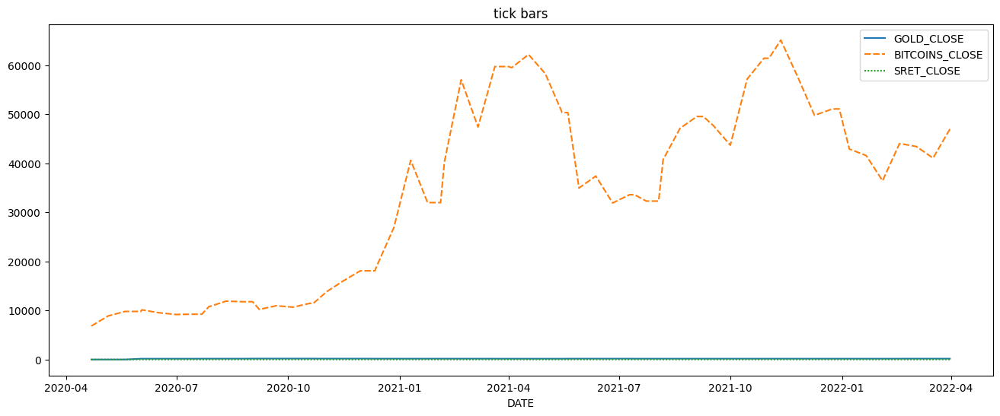

In [16]:
plt.figure(figsize=(16,6))
sns.lineplot(data=tick_bar_df[["GOLD_CLOSE", "BITCOINS_CLOSE", "SRET_CLOSE"]]).set_title('tick bars')

In [18]:
name = "GOLD"
fig = px.line(x=tick_bar_df.index, y=tick_bar_df[name+"_CLOSE"], title=f'Tick bars: {name} asset')
fig.update_layout(xaxis_title="Date",yaxis_title=name+"_CLOSE")
fig.show()
fig = go.Figure(data=[go.Candlestick(x=tick_bar_df.index,
                open=tick_bar_df[name+'_OPEN'],
                high=tick_bar_df[name+'_HIGHT'],
                low=tick_bar_df[name+'_LOW'],
                close=tick_bar_df[name+'_CLOSE'])])
fig.update_layout(xaxis_title="Date",)
fig.show()

In [19]:
name = "BITCOINS"
fig = px.line(x=tick_bar_df.index, y=tick_bar_df[name+"_CLOSE"], title=f'Tick bars: {name} asset')
fig.update_layout(xaxis_title="Date",yaxis_title=name+"_CLOSE")
fig.show()
fig = go.Figure(data=[go.Candlestick(x=tick_bar_df.index,
                open=tick_bar_df[name+'_OPEN'],
                high=tick_bar_df[name+'_HIGHT'],
                low=tick_bar_df[name+'_LOW'],
                close=tick_bar_df[name+'_CLOSE'])])
fig.update_layout(xaxis_title="Date",)
fig.show()

In [20]:

name = "SRET"
fig = px.line(x=tick_bar_df.index, y=tick_bar_df[name+"_CLOSE"], title=f'Tick bars: {name} asset')
fig.update_layout(xaxis_title="Date",yaxis_title=name+"_CLOSE")
fig.show()
fig = go.Figure(data=[go.Candlestick(x=tick_bar_df.index,
                open=tick_bar_df[name+'_OPEN'],
                high=tick_bar_df[name+'_HIGHT'],
                low=tick_bar_df[name+'_LOW'],
                close=tick_bar_df[name+'_CLOSE'])])
fig.update_layout(xaxis_title="Date",)
fig.show()

##### volume bars

In [4]:
bar_type = "volume"
bar_parameter = 2000000
assets_df = assets_df
dt = DataTransformer(assets)
volume_bar_df = dt.transform(assets_df=assets_df, bar_type=bar_type, bar_parameter=bar_parameter)

print(volume_bar_df.head(5))
print(volume_bar_df.info())

=====
asset: GOLD


100%|██████████| 279911/279911 [00:14<00:00, 19529.59it/s]


=====
asset: BITCOINS


100%|██████████| 1050945/1050945 [00:42<00:00, 24903.49it/s]


=====
asset: SRET


100%|██████████| 112834/112834 [00:04<00:00, 24358.93it/s]


                     GOLD_OPEN  GOLD_HIGHT  GOLD_LOW  GOLD_CLOSE  GOLD_VOLUME  \
DATE                                                                            
2020-04-07 17:39:00   155.8800      156.00  154.6800    154.7900    2043693.0   
2020-04-07 19:26:00   154.7798      155.55  154.5223    155.3300    2010308.0   
2020-04-08 13:45:00   155.3400      156.20  154.5000    155.7613    2010436.0   
2020-04-08 15:19:00   155.7600      155.94  154.5900    155.0350    2004592.0   
2020-04-08 17:33:00   155.0250      155.40  154.9150    155.2000    2005565.0   

                     GOLD_TRANSACTIONS  BITCOINS_OPEN  BITCOINS_HIGHT  \
DATE                                                                    
2020-04-07 17:39:00            16529.0            0.0             0.0   
2020-04-07 19:26:00            17032.0            0.0             0.0   
2020-04-08 13:45:00            13686.0            0.0             0.0   
2020-04-08 15:19:00            17292.0            0.0             0

Text(0.5, 1.0, 'volume bars')

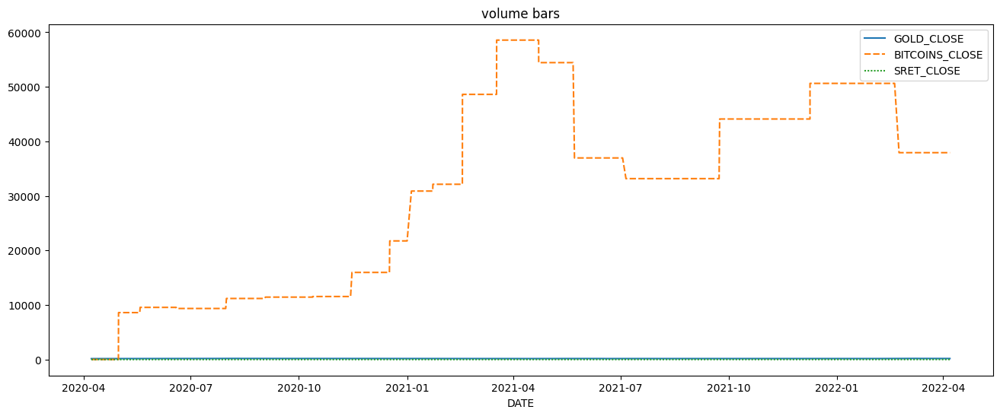

In [28]:
plt.figure(figsize=(16,6))
sns.lineplot(data=volume_bar_df[["GOLD_CLOSE", "BITCOINS_CLOSE", "SRET_CLOSE"]]).set_title('volume bars')

In [21]:
name = "GOLD"
fig = px.line(x=volume_bar_df.index, y=volume_bar_df[name+"_CLOSE"], title=f'Volume bars: {name} asset')
fig.update_layout(xaxis_title="Date",yaxis_title=name+"_CLOSE")
fig.show()
fig = go.Figure(data=[go.Candlestick(x=volume_bar_df.index,
                open=volume_bar_df[name+'_OPEN'],
                high=volume_bar_df[name+'_HIGHT'],
                low=volume_bar_df[name+'_LOW'],
                close=volume_bar_df[name+'_CLOSE'])])
fig.update_layout(xaxis_title="Date",)
fig.show()

In [22]:
name = "BITCOINS"
fig = px.line(x=volume_bar_df.index, y=volume_bar_df[name+"_CLOSE"], title=f'Volume bars: {name} asset')
fig.update_layout(xaxis_title="Date",yaxis_title=name+"_CLOSE")
fig.show()
fig = go.Figure(data=[go.Candlestick(x=volume_bar_df.index,
                open=volume_bar_df[name+'_OPEN'],
                high=volume_bar_df[name+'_HIGHT'],
                low=volume_bar_df[name+'_LOW'],
                close=volume_bar_df[name+'_CLOSE'])])
fig.update_layout(xaxis_title="Date",)
fig.show()

In [23]:
name = "SRET"
fig = px.line(x=volume_bar_df.index, y=volume_bar_df[name+"_CLOSE"], title=f'Volume bars: {name} asset')
fig.update_layout(xaxis_title="Date",yaxis_title=name+"_CLOSE")
fig.show()
fig = go.Figure(data=[go.Candlestick(x=volume_bar_df.index,
                open=volume_bar_df[name+'_OPEN'],
                high=volume_bar_df[name+'_HIGHT'],
                low=volume_bar_df[name+'_LOW'],
                close=volume_bar_df[name+'_CLOSE'])])
fig.update_layout(xaxis_title="Date",)
fig.show()

##### dollar bars

In [5]:
bar_type = "dollar"
bar_parameter = 200000000
assets_df = assets_df
dt = DataTransformer(assets)
dollar_bar_df = dt.transform(assets_df=assets_df, bar_type=bar_type, bar_parameter=bar_parameter)

print(dollar_bar_df.head(5))
print(dollar_bar_df.info())

=====
asset: GOLD


100%|██████████| 279911/279911 [00:27<00:00, 10069.85it/s]


=====
asset: BITCOINS


100%|██████████| 1050945/1050945 [01:37<00:00, 10830.92it/s]


=====
asset: SRET


100%|██████████| 112834/112834 [00:09<00:00, 11580.75it/s]

                     GOLD_OPEN  GOLD_HIGHT  GOLD_LOW  GOLD_CLOSE  GOLD_VOLUME  \
DATE                                                                            
2020-04-07 17:08:00     155.88      156.00  155.1800    155.5200    1312607.0   
2020-04-07 18:18:00     155.52      155.77  154.6200    155.4445    1293607.0   
2020-04-07 19:21:00     155.45      155.55  154.5223    155.1800    1313897.0   
2020-04-07 22:13:00     155.45      155.55  154.5223    155.1800    1313897.0   
2020-04-08 04:23:00     155.45      155.55  154.5223    155.1800    1313897.0   

                     GOLD_TRANSACTIONS  BITCOINS_OPEN  BITCOINS_HIGHT  \
DATE                                                                    
2020-04-07 17:08:00            11010.0           0.00            0.00   
2020-04-07 18:18:00            10417.0           0.00            0.00   
2020-04-07 19:21:00            11158.0           0.00            0.00   
2020-04-07 22:13:00            11158.0        7363.09         7371.

Text(0.5, 1.0, 'dollar bars')

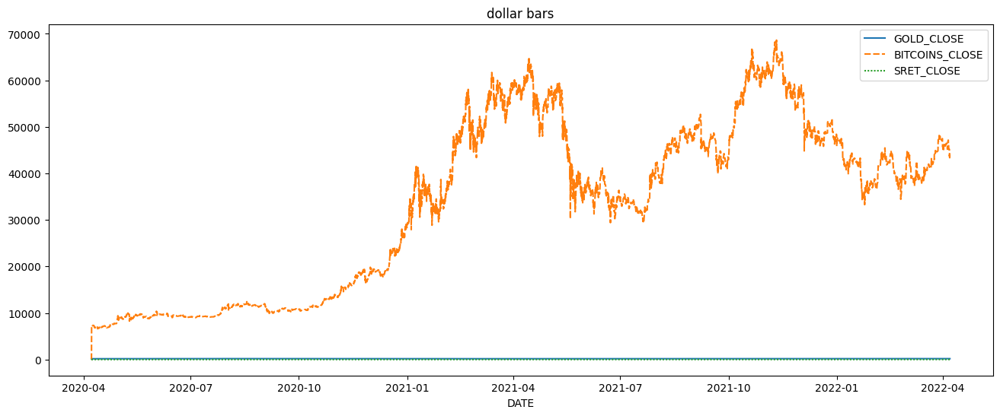

In [29]:
plt.figure(figsize=(16,6))
sns.lineplot(data=dollar_bar_df[["GOLD_CLOSE", "BITCOINS_CLOSE", "SRET_CLOSE"]]).set_title('dollar bars')

In [24]:
name = "GOLD"
fig = px.line(x=dollar_bar_df.index, y=dollar_bar_df[name+"_CLOSE"], title=f'Dollar bars: {name} asset')
fig.update_layout(xaxis_title="Date",yaxis_title=name+"_CLOSE")
fig.show()
fig = go.Figure(data=[go.Candlestick(x=dollar_bar_df.index,
                open=dollar_bar_df[name+'_OPEN'],
                high=dollar_bar_df[name+'_HIGHT'],
                low=dollar_bar_df[name+'_LOW'],
                close=dollar_bar_df[name+'_CLOSE'])])
fig.update_layout(xaxis_title="Date",)
fig.show()

In [25]:
name = "BITCOINS"
fig = px.line(x=dollar_bar_df.index, y=dollar_bar_df[name+"_CLOSE"], title=f'Dollar bars: {name} asset')
fig.update_layout(xaxis_title="Date",yaxis_title=name+"_CLOSE")
fig.show()
fig = go.Figure(data=[go.Candlestick(x=dollar_bar_df.index,
                open=dollar_bar_df[name+'_OPEN'],
                high=dollar_bar_df[name+'_HIGHT'],
                low=dollar_bar_df[name+'_LOW'],
                close=dollar_bar_df[name+'_CLOSE'])])
fig.update_layout(xaxis_title="Date",)
fig.show()

In [26]:
name = "SRET"
fig = px.line(x=dollar_bar_df.index, y=dollar_bar_df[name+"_CLOSE"], title=f'Dollar bars: {name} asset')
fig.update_layout(xaxis_title="Date",yaxis_title=name+"_CLOSE")
fig.show()
fig = go.Figure(data=[go.Candlestick(x=dollar_bar_df.index,
                open=dollar_bar_df[name+'_OPEN'],
                high=dollar_bar_df[name+'_HIGHT'],
                low=dollar_bar_df[name+'_LOW'],
                close=dollar_bar_df[name+'_CLOSE'])])
fig.update_layout(xaxis_title="Date",)
fig.show()